# Introduction 

## Problem Statement 

Predicting prices based on house features

## Approach and Methodology 

![ML Workflow](https://d2908q01vomqb2.cloudfront.net/f1f836cb4ea6efb2a0b1b99f41ad8b103eff4b59/2019/04/17/sagemaker-airflow-1.gif)

For the approach, we are going to follow the machine learning workflow as attached above.

This problem is a linear regression problem because it involves predicting a value. So, let's look at machine learning algorithms cheatsheet provided by SAS and Microsoft.

![SAS Algo Cheatsheet](https://99181-282044-raikfcquaxqncofqfm.stackpathdns.com/wp-content/uploads/2017/04/CheatSheet.png)
![MS Algo CS](https://docs.microsoft.com/en-us/azure/machine-learning/media/algorithm-cheat-sheet/machine-learning-algorithm-cheat-sheet.svg)

From the cheatsheets above, we can try several algorithms:

1. Linear Regression as a starter because it is fast and simple.
2. Decision tree regression because it is more accurate and fast.
3. In the future, we can consider using k-means to classify zipcodes into regions, then run decisiton tree regression to predict the price. 

# Obtain Data

In [1]:
import numpy as np
import pandas as pd

import sklearn

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
plt.style.use('ggplot')


print("numpy version {}".format(np.__version__))
print("pandas version {}".format(pd.__version__))
print("sklearn version {}".format(sklearn.__version__))

numpy version 1.18.1
pandas version 1.0.3
sklearn version 0.23.1


## Load Data

In [2]:
data = pd.read_csv("./data/kc_house_data.csv")

In [3]:
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [5]:
data.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


In [6]:
df = data.iloc[:]

# Data Cleaning and Exploration

## Data Type 

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

Insights:
* We can convert the date into datetime object to help us investigate the data using date/month/year. 
* Number of bathrooms are represented as float instead of int. 

In [8]:
df['date'] = pd.to_datetime(df['date'])
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [9]:
def val_count (col):
    '''function to get uniquevalue count for any column'''
    display(df[col].value_counts())

In [10]:
val_count("bathrooms")

2.50    5380
1.00    3852
1.75    3048
2.25    2047
2.00    1930
1.50    1446
2.75    1185
3.00     753
3.50     731
3.25     589
3.75     155
4.00     136
4.50     100
4.25      79
0.75      72
4.75      23
5.00      21
5.25      13
0.00      10
5.50      10
1.25       9
6.00       6
0.50       4
5.75       4
8.00       2
6.25       2
6.50       2
6.75       2
7.50       1
7.75       1
Name: bathrooms, dtype: int64

According to an [article](https://www.realtor.com/advice/sell/if-i-take-out-the-tub-does-a-bathroom-still-count-as-a-full-bath/) from www.realtor.com, a full bathroom is made up of four parts: a sink, a shower, a bathtub, and a toilet. Hence, the `bathrooms` column refers to the number of bathrooms where the decimal points means that there are bathrooms without one/some of the four parts.

Because the decimal points are there for a valid reason, we are not going to round this up.

## Null Values 

In [11]:
df.isnull().sum()

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

There is no null values in the dataframe.

## Duplicates 

In [12]:
# check for duplicate rows based on id
duplicates = df[df.duplicated(subset=['id'], keep=False)]
print("Number of rows with duplicated id {}".format(len(duplicates)))
display(duplicates.sort_values(by=["id"]).head())

Number of rows with duplicated id 353


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
2497,1000102,2015-04-22,300000.0,6,3.00,2400,9373,2.0,0,0,...,7,2400,0,1991,0,98002,47.3262,-122.214,2060,7316
2496,1000102,2014-09-16,280000.0,6,3.00,2400,9373,2.0,0,0,...,7,2400,0,1991,0,98002,47.3262,-122.214,2060,7316
16814,7200179,2014-10-16,150000.0,2,1.00,840,12750,1.0,0,0,...,6,840,0,1925,0,98055,47.4840,-122.211,1480,6969
16815,7200179,2015-04-24,175000.0,2,1.00,840,12750,1.0,0,0,...,6,840,0,1925,0,98055,47.4840,-122.211,1480,6969
11434,109200390,2014-10-20,250000.0,3,1.75,1480,3900,1.0,0,0,...,7,1480,0,1980,0,98023,47.2977,-122.367,1830,6956


In [13]:
# check for duplicate rows based on id
duplicates = df[df.duplicated(subset=['id', 'date'], keep=False)]
print("Number of rows with duplicated id and date {}".format(len(duplicates)))
duplicates.sort_values(by=["id"]).head(10)

Number of rows with duplicated id and date 0


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15


Firstly, we checked duplicated rows based on `id` and there were 210 duplicated rows. After looking at the duplicated rows, we can see that the same house could be sold twice. Therefore, we can check for duplicated rows again based on both `id` and `date` because it is not possible to sell the house twice on the same day.

We have found that there is no duplicated rows in the dataframe.

We can make a new feature called `resold` based on this information.

## Outliers

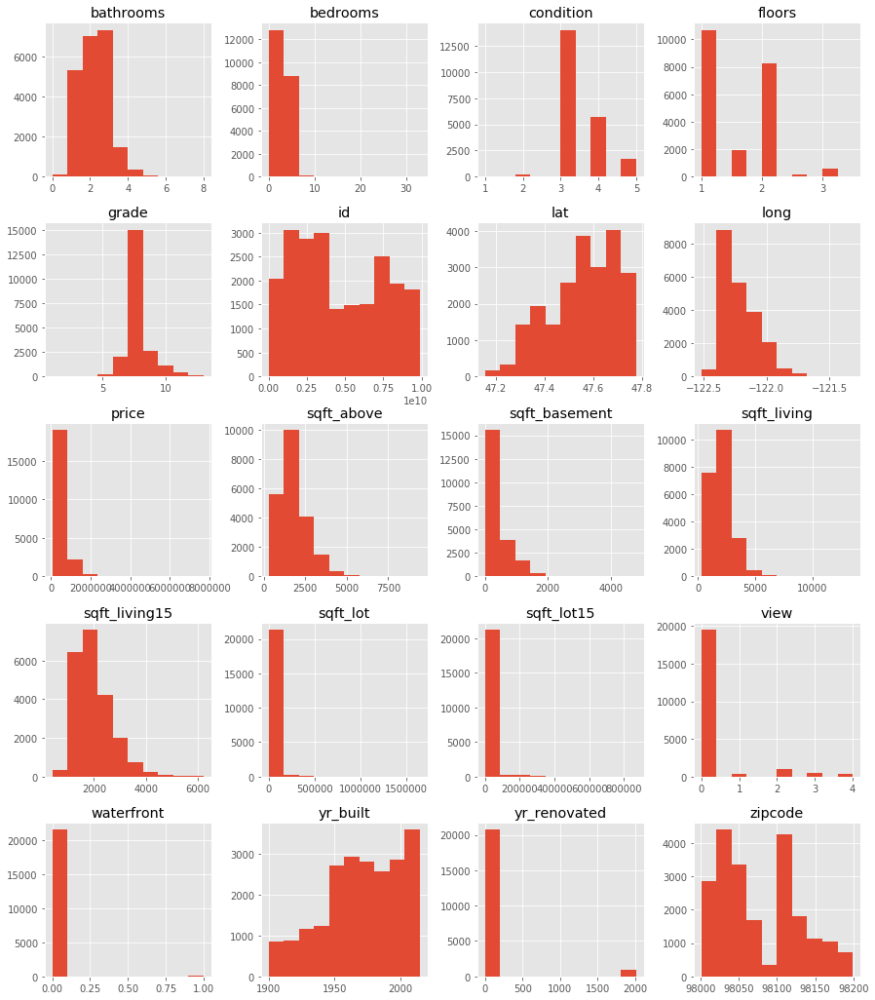

In [14]:
df.hist(figsize = (15,18))
plt.show()

Insights:
* `bathrooms`, `condition`, `floors`, and `grade` are distributed evenly.
* There seem to be outliers for `bedrooms`, `price`, `sqft_living`, `sqft_lot`, and `sqft_lot15`.
* There are a lot of 0 value for `view` and `yr_renovated`, we can investigate further to see if it is better to represent these values as boolean values.

Let's examine `bedrooms` first

In [15]:
val_count("bedrooms")

3     9824
4     6882
2     2760
5     1601
6      272
1      199
7       38
8       13
0       13
9        6
10       3
11       1
33       1
Name: bedrooms, dtype: int64

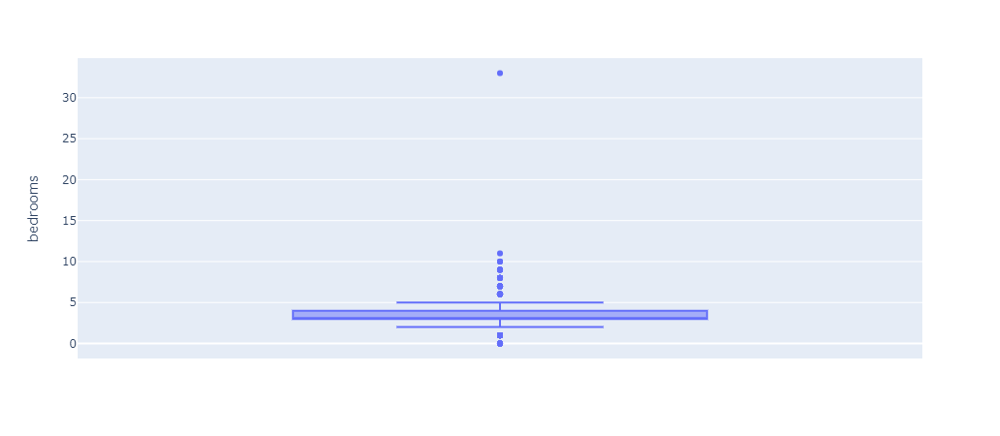

In [16]:
import plotly.express as px
fig = px.box(df, y="bedrooms")
fig.show()

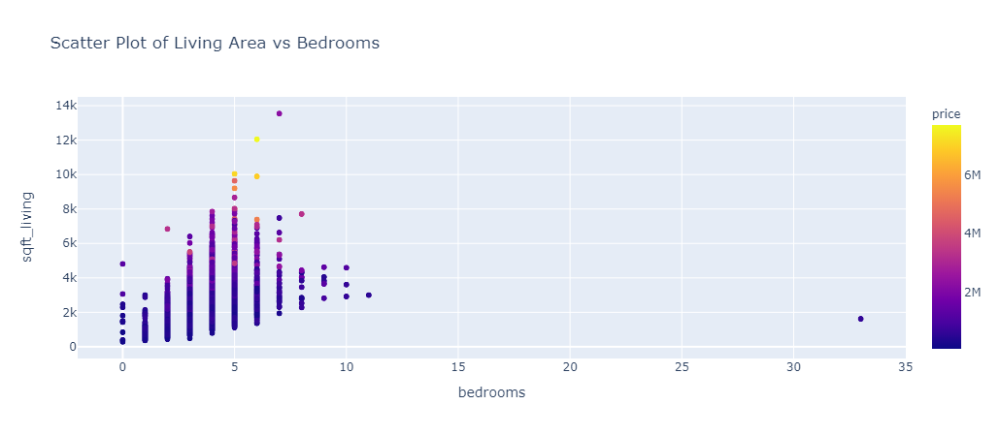

In [17]:
fig = px.scatter(data_frame=df, x=df["bedrooms"], y=df["sqft_living"], color="price", title="Scatter Plot of Living Area vs Bedrooms")
fig.show()

In [18]:
df[df["bedrooms"] > 7].sort_values(by=["bedrooms"])

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
1660,9126101740,2014-12-04,490000.0,8,5.00,2800,2580,2.0,0,0,...,8,1880,920,1997,0,98122,47.6086,-122.303,1800,2580
18477,1346300150,2014-10-20,3300000.0,8,4.00,7710,11750,3.5,0,0,...,12,6090,1620,1904,0,98112,47.6263,-122.314,4210,8325
17235,1338600225,2014-05-28,1970000.0,8,3.50,4440,6480,2.0,0,3,...,10,3140,1300,1959,0,98112,47.6310,-122.303,4440,8640
15670,8141200080,2014-08-14,680000.0,8,2.75,2530,4800,2.0,0,0,...,7,1390,1140,1901,0,98112,47.6241,-122.305,1540,4800
15070,7418000130,2014-12-11,430000.0,8,3.25,4300,10441,2.0,0,0,...,8,2800,1500,1979,0,98059,47.4786,-122.131,1780,10457
12885,8813400155,2014-12-19,808000.0,8,3.75,3460,4600,2.0,0,0,...,7,2860,600,1987,0,98105,47.6617,-122.289,2170,3750
9452,2769600590,2014-10-16,900000.0,8,4.00,4020,7500,1.0,0,0,...,8,2010,2010,1968,0,98107,47.6732,-122.363,1560,3737
9077,6746700615,2015-03-18,700000.0,8,2.50,2280,3000,1.5,0,0,...,7,1210,1070,1911,0,98105,47.6675,-122.316,1610,3000
10958,1652500060,2014-07-11,1650000.0,8,2.75,4040,20666,1.0,0,0,...,9,2020,2020,1962,0,98004,47.6340,-122.221,3670,20500
6174,1873400020,2014-07-03,340000.0,8,2.75,2790,6695,1.0,0,0,...,7,1470,1320,1977,0,98133,47.7565,-122.331,1760,7624


Considering the relatively low living space (1620), price ($640k), and bathrooms for the house with 33 bedrooms, there is a possibility that it is not a valid number. Therefore, we are going to drop it.

In [19]:
df = df.drop(index = df[df["bedrooms"] > 15].index)

Next, we are going to look at `price`

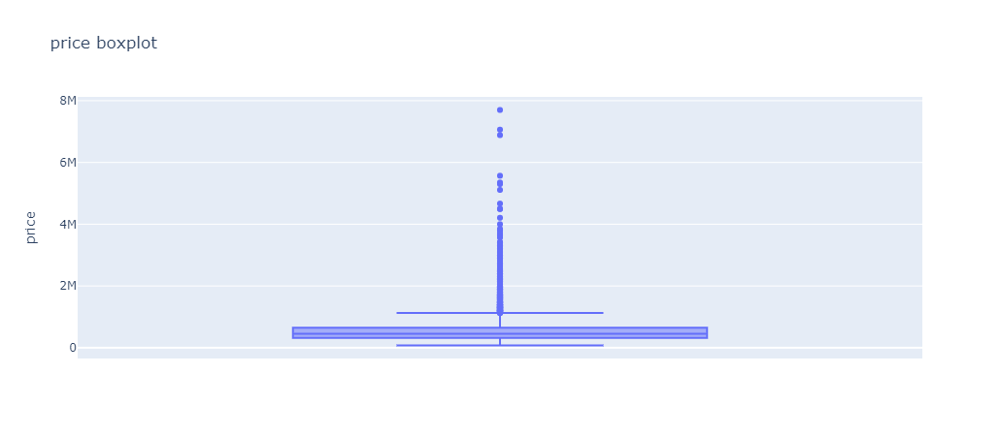

In [20]:
fig = px.box(df, y="price", title="price boxplot")
fig.show()

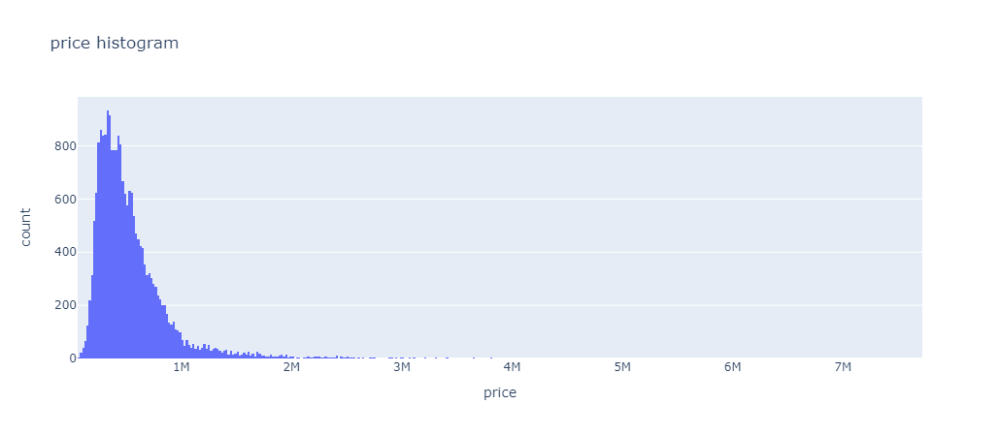

In [21]:
import plotly.express as px
fig = px.histogram(data, title="price histogram", x="price")
fig.show()

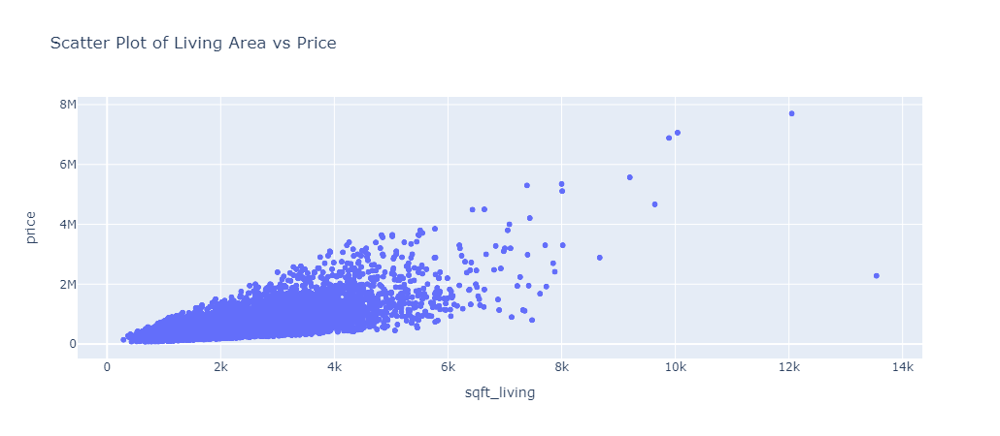

In [22]:
fig = px.scatter(data_frame=df, 
                 x=df["sqft_living"], 
                 y=df["price"], 
                 title="Scatter Plot of Living Area vs Price")

fig.show()

In [23]:
percentile99 = df["price"].quantile(q=0.99)
print("99 percentile: {}".format(percentile99))

99 percentile: 1964449.9999999972


In [24]:
above99 = df[df["price"] > percentile99].sort_values(by=["price"], ascending=False)
above99.head(10)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
7252,6762700020,2014-10-13,7700000.0,6,8.00,12050,27600,2.5,0,3,...,13,8570,3480,1910,1987,98102,47.6298,-122.323,3940,8800
3914,9808700762,2014-06-11,7062500.0,5,4.50,10040,37325,2.0,1,2,...,11,7680,2360,1940,2001,98004,47.6500,-122.214,3930,25449
9254,9208900037,2014-09-19,6885000.0,6,7.75,9890,31374,2.0,0,4,...,13,8860,1030,2001,0,98039,47.6305,-122.240,4540,42730
4411,2470100110,2014-08-04,5570000.0,5,5.75,9200,35069,2.0,0,0,...,13,6200,3000,2001,0,98039,47.6289,-122.233,3560,24345
1448,8907500070,2015-04-13,5350000.0,5,5.00,8000,23985,2.0,0,4,...,12,6720,1280,2009,0,98004,47.6232,-122.220,4600,21750
1315,7558700030,2015-04-13,5300000.0,6,6.00,7390,24829,2.0,1,4,...,12,5000,2390,1991,0,98040,47.5631,-122.210,4320,24619
1164,1247600105,2014-10-20,5110800.0,5,5.25,8010,45517,2.0,1,4,...,12,5990,2020,1999,0,98033,47.6767,-122.211,3430,26788
8092,1924059029,2014-06-17,4668000.0,5,6.75,9640,13068,1.0,1,4,...,12,4820,4820,1983,2009,98040,47.5570,-122.210,3270,10454
2626,7738500731,2014-08-15,4500000.0,5,5.50,6640,40014,2.0,1,4,...,12,6350,290,2004,0,98155,47.7493,-122.280,3030,23408
8638,3835500195,2014-06-18,4489000.0,4,3.00,6430,27517,2.0,0,0,...,12,6430,0,2001,0,98004,47.6208,-122.219,3720,14592


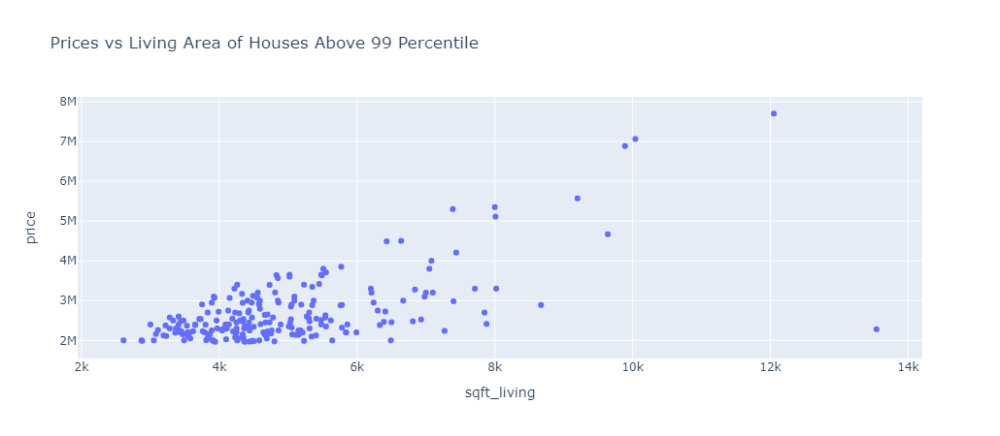

In [25]:
fig = px.scatter(above99, title="Prices vs Living Area of Houses Above 99 Percentile", x="sqft_living", y="price")
fig.show()

The houses with prices above the 99th percentile tend to have bigger living area. Because these houses are rare and it causes noise in our data, we can drop the outliers.

In [26]:
df = df.drop(index = df[df["price"] > percentile99].index)

`sqft_lot`

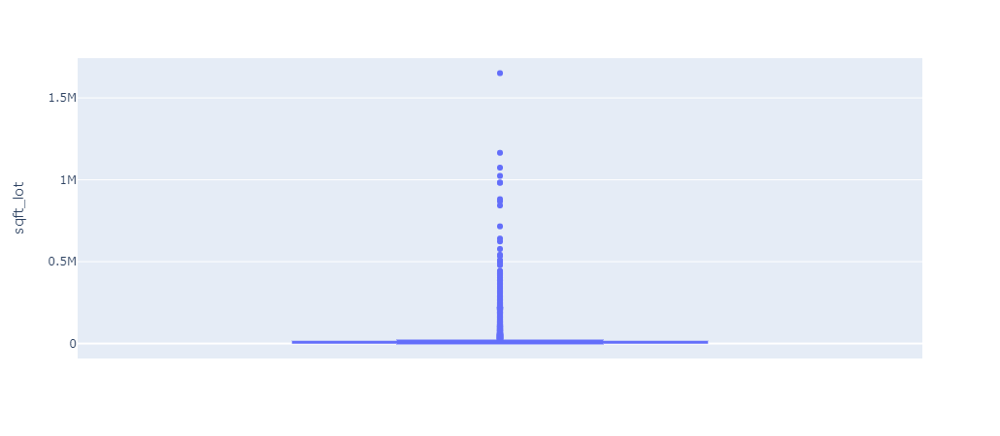

In [27]:
fig = px.box(df, y="sqft_lot")
fig.show()

In [28]:
lot_percentile99 = df["sqft_lot"].quantile(q=0.99)
print("99 percentile: {}".format(lot_percentile99))

99 percentile: 213008.0


In [29]:
lot_above99 = df[df["sqft_lot"] > lot_percentile99].sort_values(by=["sqft_lot"], ascending=False)
lot_above99.head(5)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
1719,1020069017,2015-03-27,700000.0,4,1.00,1300,1651359,1.0,0,3,...,6,1300,0,1920,0,98022,47.2313,-122.023,2560,425581
17319,3326079016,2015-05-04,190000.0,2,1.00,710,1164794,1.0,0,0,...,5,710,0,1915,0,98014,47.6888,-121.909,1680,16730
7647,2623069031,2014-05-21,542500.0,5,3.25,3010,1074218,1.5,0,0,...,8,2010,1000,1931,0,98027,47.4564,-122.004,2450,68825
7769,2323089009,2015-01-19,855000.0,4,3.50,4030,1024068,2.0,0,0,...,10,4030,0,2006,0,98045,47.4619,-121.744,1830,11700
3949,722069232,2014-09-05,998000.0,4,3.25,3770,982998,2.0,0,0,...,10,3770,0,1992,0,98058,47.4140,-122.087,2290,37141


After examining the zipcode on google maps satellite, we found out that the records with the highest sqft_lot seems to be located in a remote area with a lot of unused land. Hence, there is a possibility of these properties being used as farmlands. 

`yr_renovated`

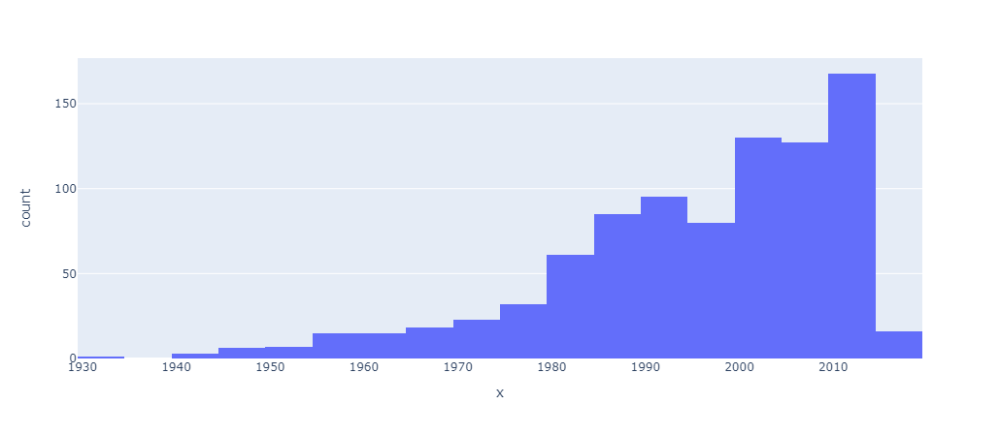

In [30]:
fig = px.histogram(x=df[df["yr_renovated"] > 1900]["yr_renovated"])
fig.show()

Renovations before 1990 would have less of an impact on the house anymore by 2014-2015. Therefore, we are going to make a new boolean feature `renovated90`, where the renovations done before year 1990 would have 0 and renovations after 1990 would be 1.

# Data Exploration 

## Location 

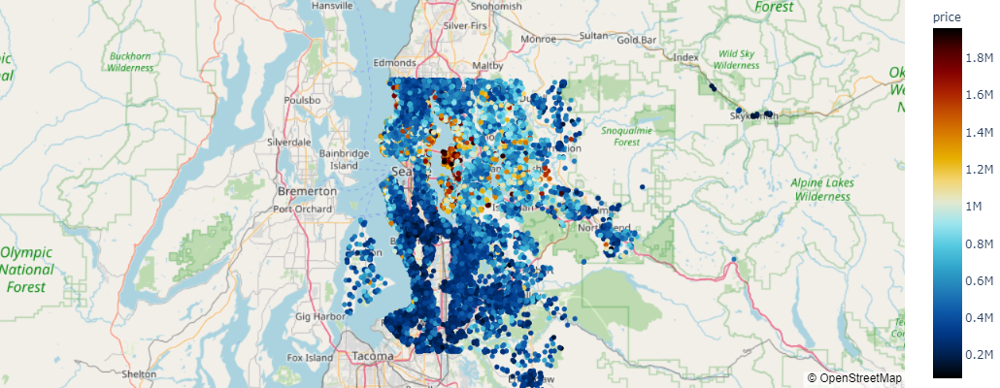

In [31]:
import plotly.express as px

fig = px.scatter_mapbox(df, 
                        lat="lat", 
                        lon="long", 
                        hover_name="id", 
                        hover_data=["price", "yr_built", "yr_renovated"],
                        color="price", 
                        color_continuous_scale=px.colors.cyclical.IceFire, 
                        zoom=8, 
                        height=400)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

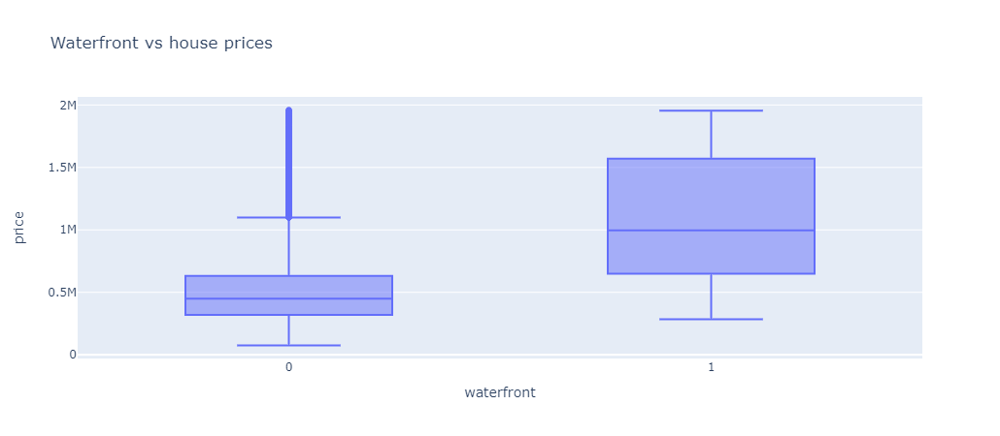

In [32]:
import plotly.express as px
fig = px.box(df, x="waterfront", y="price", title="Waterfront vs house prices")
fig.show()

Insights:
* Houses located on the waterfront have higher median price compared to the ones that are not.

## Living/Lot Ratio 

In [33]:
df['living_lot_ratio'] = df['sqft_living']/df['sqft_lot']
df['living_lot_ratio'].describe()

count    21395.000000
mean         0.323348
std          0.269077
min          0.000610
25%          0.156221
50%          0.247059
75%          0.406663
max          4.653846
Name: living_lot_ratio, dtype: float64

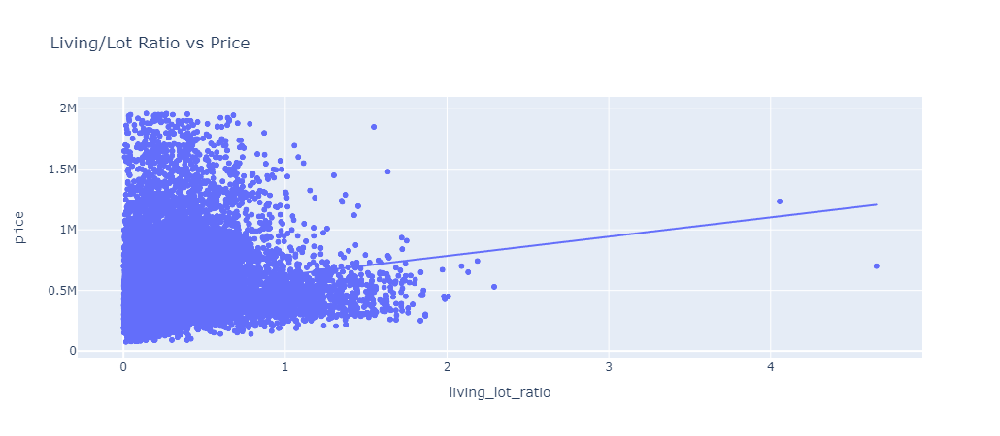

In [34]:
fig = px.scatter(df, x="living_lot_ratio", y="price", title="Living/Lot Ratio vs Price", trendline="ols")
fig.show()

Insights: 
* There seem to be a weak positive correlation between the living/lot ratio and price, with several outliers.

Now, Let's see the correlation between small living/lot ratio (small living space, large lot) and price.

In [35]:
df_1 = df[df['living_lot_ratio'] < 1]

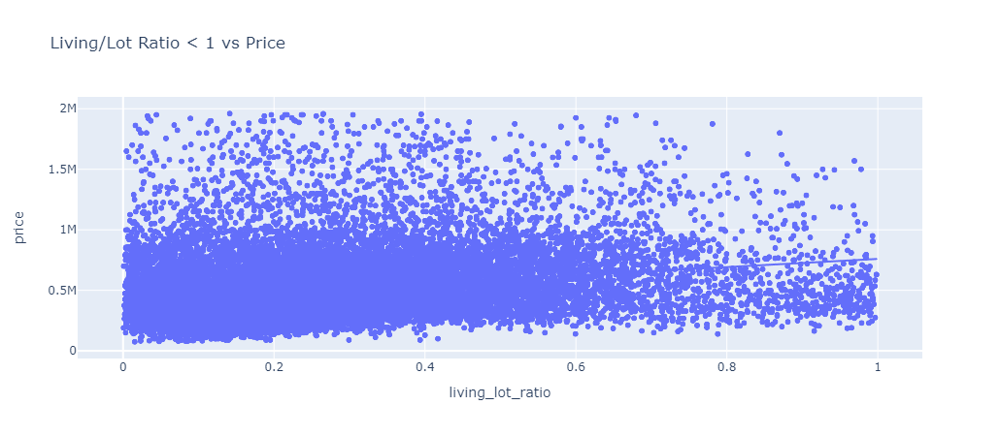

In [36]:
fig = px.scatter(df_1, x="living_lot_ratio", y="price", title="Living/Lot Ratio < 1 vs Price", trendline="ols")
fig.show()

This graph shows that there is little to no correlation between having a large lot and the price.

# Feature Engineering 

## Resold Houses 

In [37]:
# check for duplicate rows based on id
duplicates = df[df.duplicated(subset=['id'], keep='first')]
print("Number of rows with duplicated id {}".format(len(duplicates)))
duplicates.sort_values(by=["id"]).head(10)

Number of rows with duplicated id 177


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,living_lot_ratio
2497,1000102,2015-04-22,300000.0,6,3.00,2400,9373,2.0,0,0,...,2400,0,1991,0,98002,47.3262,-122.214,2060,7316,0.256055
16815,7200179,2015-04-24,175000.0,2,1.00,840,12750,1.0,0,0,...,840,0,1925,0,98055,47.4840,-122.211,1480,6969,0.065882
11434,109200390,2014-10-20,250000.0,3,1.75,1480,3900,1.0,0,0,...,1480,0,1980,0,98023,47.2977,-122.367,1830,6956,0.379487
12418,123039336,2014-12-08,244900.0,1,1.00,620,8261,1.0,0,0,...,620,0,1939,0,98106,47.5138,-122.364,1180,8244,0.075051
7793,251300110,2015-01-14,358000.0,3,2.25,2510,12013,2.0,0,0,...,2510,0,1988,0,98003,47.3473,-122.314,1870,8017,0.208940
9235,302000375,2015-05-06,250000.0,3,2.00,1050,18304,1.0,0,0,...,1050,0,1953,0,98001,47.3206,-122.269,1690,15675,0.057365
14856,324000530,2015-03-23,459000.0,3,1.00,1320,5000,1.5,0,0,...,1320,0,1912,0,98116,47.5711,-122.386,1320,4179,0.264000
7179,526059224,2015-02-06,470000.0,4,1.75,1650,7276,1.0,0,0,...,1010,640,1977,0,98011,47.7721,-122.206,1840,8550,0.226773
17382,641900050,2015-02-06,499950.0,4,2.25,2160,8817,1.0,0,0,...,1460,700,1965,0,98133,47.7595,-122.356,1880,8817,0.244981
19553,643300040,2015-03-13,719521.0,4,1.75,1920,9500,1.0,0,0,...,1470,450,1966,0,98006,47.5683,-122.177,1820,10091,0.202105


In [38]:
# get true/false value for resold houses and concatenate to df
resold = pd.DataFrame(df.duplicated(subset=['id'], keep='first').astype(int), columns = ["resold"])
df = pd.concat([df, resold], axis=1)
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,living_lot_ratio,resold
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,...,0,1955,0,98178,47.5112,-122.257,1340,5650,0.208850,0
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,...,400,1951,1991,98125,47.7210,-122.319,1690,7639,0.354874,0
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,...,0,1933,0,98028,47.7379,-122.233,2720,8062,0.077000,0
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,...,910,1965,0,98136,47.5208,-122.393,1360,5000,0.392000,0
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,...,0,1987,0,98074,47.6168,-122.045,1800,7503,0.207921,0


## Renovated after 1990 

In [39]:
display(df[df['yr_renovated'] > 1990]['yr_renovated'].value_counts())
len(df[df['yr_renovated'] > 1990]['yr_renovated'])

2014    91
2013    36
2003    34
2000    34
2007    34
2005    34
2004    25
2006    23
2009    20
1998    19
2002    19
1991    19
2001    18
2010    17
1994    17
1993    17
1992    17
2008    16
1999    16
2015    16
1997    15
1996    15
1995    15
2011    13
2012    11
Name: yr_renovated, dtype: int64

591

In [40]:
df['yr_renovated'].map(lambda x: 1 if x > 1990 else 0).value_counts()

0    20804
1      591
Name: yr_renovated, dtype: int64

In [41]:
df['renovated90'] = df['yr_renovated'].map(lambda x: 1 if x > 1990 else 0)
df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,living_lot_ratio,resold,renovated90
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,...,1955,0,98178,47.5112,-122.257,1340,5650,0.208850,0,0
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,...,1951,1991,98125,47.7210,-122.319,1690,7639,0.354874,0,1
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,...,1933,0,98028,47.7379,-122.233,2720,8062,0.077000,0,0
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,...,1965,0,98136,47.5208,-122.393,1360,5000,0.392000,0,0
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,...,1987,0,98074,47.6168,-122.045,1800,7503,0.207921,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,2014-05-21,360000.0,3,2.50,1530,1131,3.0,0,0,...,2009,0,98103,47.6993,-122.346,1530,1509,1.352785,0,0
21609,6600060120,2015-02-23,400000.0,4,2.50,2310,5813,2.0,0,0,...,2014,0,98146,47.5107,-122.362,1830,7200,0.397385,0,0
21610,1523300141,2014-06-23,402101.0,2,0.75,1020,1350,2.0,0,0,...,2009,0,98144,47.5944,-122.299,1020,2007,0.755556,0,0
21611,291310100,2015-01-16,400000.0,3,2.50,1600,2388,2.0,0,0,...,2004,0,98027,47.5345,-122.069,1410,1287,0.670017,0,0


In [42]:
df = df.drop(columns=["yr_renovated"])

## Month Sold

In [43]:
df['month'] = pd.DatetimeIndex(df["date"]).month
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,yr_built,zipcode,lat,long,sqft_living15,sqft_lot15,living_lot_ratio,resold,renovated90,month
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,...,1955,98178,47.5112,-122.257,1340,5650,0.208850,0,0,10
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,...,1951,98125,47.7210,-122.319,1690,7639,0.354874,0,1,12
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,...,1933,98028,47.7379,-122.233,2720,8062,0.077000,0,0,2
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,...,1965,98136,47.5208,-122.393,1360,5000,0.392000,0,0,12
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,...,1987,98074,47.6168,-122.045,1800,7503,0.207921,0,0,2


Text(0.5, 1.0, 'Month vs House Sold Frequency')

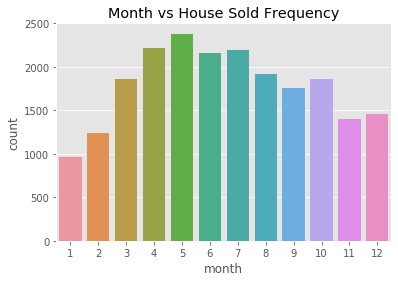

In [44]:
sns.countplot(data=df, x = df['month'])
plt.title("Month vs House Sold Frequency")

## Age

This is the age at the point the house was sold.

In [45]:
df['age'] = pd.DatetimeIndex(df["date"]).year - df['yr_built']

In [46]:
df = df.drop(columns=['yr_built'])

In [47]:
df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,zipcode,lat,long,sqft_living15,sqft_lot15,living_lot_ratio,resold,renovated90,month,age
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,...,98178,47.5112,-122.257,1340,5650,0.208850,0,0,10,59
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,...,98125,47.7210,-122.319,1690,7639,0.354874,0,1,12,63
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,...,98028,47.7379,-122.233,2720,8062,0.077000,0,0,2,82
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,...,98136,47.5208,-122.393,1360,5000,0.392000,0,0,12,49
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,...,98074,47.6168,-122.045,1800,7503,0.207921,0,0,2,28
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,2014-05-21,360000.0,3,2.50,1530,1131,3.0,0,0,...,98103,47.6993,-122.346,1530,1509,1.352785,0,0,5,5
21609,6600060120,2015-02-23,400000.0,4,2.50,2310,5813,2.0,0,0,...,98146,47.5107,-122.362,1830,7200,0.397385,0,0,2,1
21610,1523300141,2014-06-23,402101.0,2,0.75,1020,1350,2.0,0,0,...,98144,47.5944,-122.299,1020,2007,0.755556,0,0,6,5
21611,291310100,2015-01-16,400000.0,3,2.50,1600,2388,2.0,0,0,...,98027,47.5345,-122.069,1410,1287,0.670017,0,0,1,11


## Drop Unnecessary Features

In [48]:
df = df.drop(columns=["id", "date", "lat", "long"])

# Preparing Data for Modelling 

## Investigate Multicolinearity 

In [49]:
# Correlation
corr = df.corr()

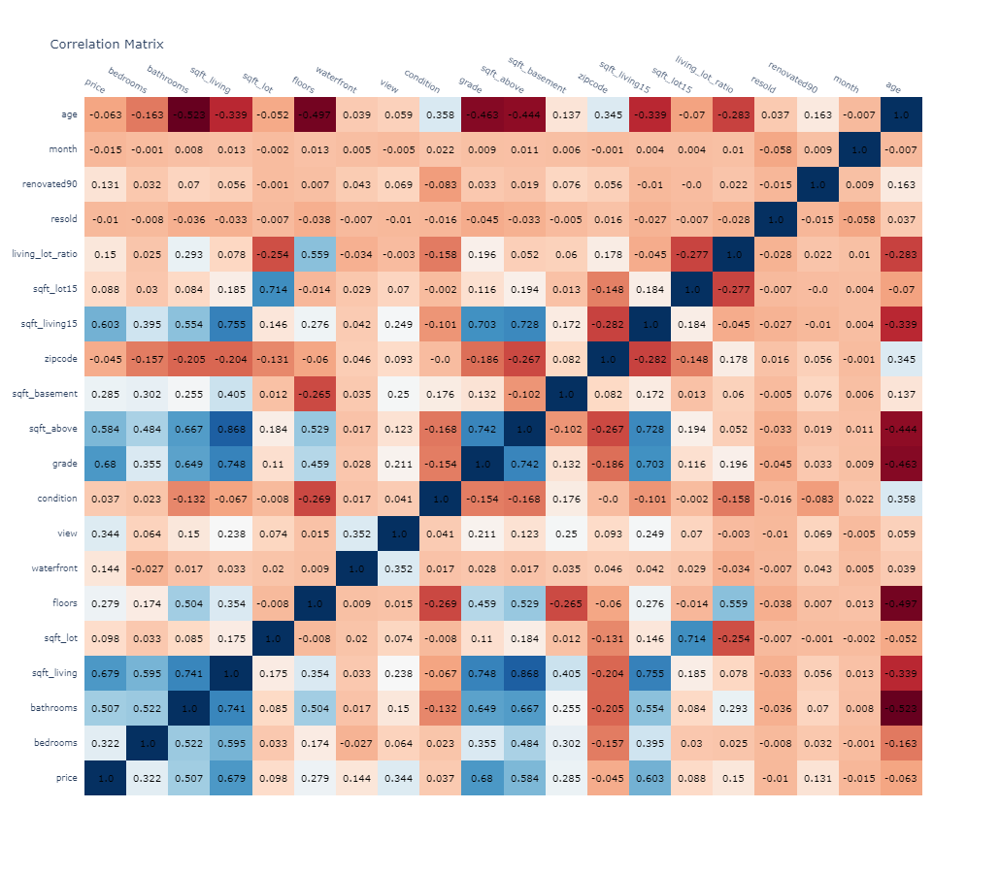

In [50]:
import plotly.figure_factory as ff

colorscale = 'rdbu'
font_colors = ['black']
heatmapdata = np.array(np.round(corr, 3))
x_axis = list(corr.columns)
y_axis = list(corr.index)
fig = ff.create_annotated_heatmap(heatmapdata, x=x_axis, y=y_axis, colorscale=colorscale, font_colors=font_colors)
for i in range(len(fig.layout.annotations)):
    fig.layout.annotations[i].font.size = 10
    
fig.update_layout(
    font=dict(
        size=9,
    ),
    height= 900,
    title="Correlation Matrix"
)
fig.show()

Insights:
* `sqft_living` and `sqft_above` are highly correlated because `sqft_above` is just `sqft_living` without `sqft_basement` and most houses does not have a basement. We will choose to drop `sqft_above` and keep `sqft_living`.

* `sqft_living` and `sqft_living15` are also highly correlated. We will choose to keep `sqft_living` again as it explains individual houses.

* `sqft_lot`, `sqft_lot15` are highly correlated. We will keep `sqft_lot` because it explains the inidividual houses.

In [51]:
df = df.drop(columns=["sqft_above", "sqft_living15", "sqft_lot15"])

## Encode Discrete Values 

In [52]:
def encode(df, discretecol):
    dfonehot = df[discretecol].astype('category')
    dfonehot = pd.get_dummies(dfonehot, prefix=discretecol, drop_first = True)
    df = pd.concat([df, dfonehot], axis = 1)
    df = df.drop(discretecol, axis = 1)
    return df

In [53]:
df = encode(df, "bedrooms")
df = encode(df, "bathrooms")
df = encode(df, "view")
df = encode(df, "condition")
df = encode(df, "zipcode")
df = encode(df, "month")
df = encode(df, "age")

In [54]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21395 entries, 0 to 21612
Columns: 251 entries, price to age_115
dtypes: float64(3), int32(1), int64(6), uint8(241)
memory usage: 7.3 MB


# Train Test Split 

In [55]:
X = df.drop('price', axis = 1)
y = df['price']

In [56]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=16)

In [57]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(14976, 250) (6419, 250) (14976,) (6419,)


In [58]:
df = pd.concat([X_train, y_train], axis = 1)
df.head()

,sqft_living,sqft_lot,floors,waterfront,grade,sqft_basement,living_lot_ratio,resold,renovated90,bedrooms_1,...,age_107,age_108,age_109,age_110,age_111,age_112,age_113,age_114,age_115,price
3922,1370,4866,1.0,0,8,0,0.281545,0,0,0,...,0,0,0,0,0,0,0,0,0,431500.0
11377,1810,8158,1.0,0,8,360,0.221868,0,0,0,...,0,0,0,0,0,0,0,0,0,507000.0
3313,2230,32660,1.0,0,8,0,0.068279,0,0,0,...,0,0,0,0,0,0,0,0,0,428000.0
14821,4570,16015,2.0,0,11,0,0.285357,0,0,0,...,0,0,0,0,0,0,0,0,0,1060000.0
15174,1670,6000,1.0,0,7,580,0.278333,0,0,0,...,0,0,0,0,0,0,0,0,0,612125.0


In [59]:
df_test = pd.concat([X_test, y_test], axis = 1)

In [60]:
df_test.head()

,sqft_living,sqft_lot,floors,waterfront,grade,sqft_basement,living_lot_ratio,resold,renovated90,bedrooms_1,...,age_107,age_108,age_109,age_110,age_111,age_112,age_113,age_114,age_115,price
3518,2550,8976,1.0,0,7,1250,0.284091,0,0,0,...,0,0,0,0,0,0,0,0,0,328950.0
10581,790,14200,1.0,0,7,0,0.055634,0,0,0,...,0,0,0,0,0,0,0,0,0,198000.0
9858,2880,5500,2.0,0,9,960,0.523636,0,0,0,...,0,0,0,0,0,0,0,0,0,1100000.0
4176,1250,4800,1.0,0,7,0,0.260417,0,0,0,...,0,0,0,0,0,0,0,0,0,340000.0
12494,2080,5750,1.0,0,7,1040,0.361739,0,0,0,...,0,0,0,0,0,0,0,0,0,660000.0


In [61]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14976 entries, 3922 to 6898
Columns: 250 entries, sqft_living to age_115
dtypes: float64(2), int32(1), int64(6), uint8(241)
memory usage: 4.5 MB


# Modelling

In [62]:
X_train

,sqft_living,sqft_lot,floors,waterfront,grade,sqft_basement,living_lot_ratio,resold,renovated90,bedrooms_1,...,age_106,age_107,age_108,age_109,age_110,age_111,age_112,age_113,age_114,age_115
3922,1370,4866,1.0,0,8,0,0.281545,0,0,0,...,0,0,0,0,0,0,0,0,0,0
11377,1810,8158,1.0,0,8,360,0.221868,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3313,2230,32660,1.0,0,8,0,0.068279,0,0,0,...,0,0,0,0,0,0,0,0,0,0
14821,4570,16015,2.0,0,11,0,0.285357,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15174,1670,6000,1.0,0,7,580,0.278333,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17897,4030,36762,2.0,0,11,0,0.109624,0,0,0,...,0,0,0,0,0,0,0,0,0,0
590,1830,217800,1.0,0,7,820,0.008402,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2194,2050,10519,1.0,0,7,810,0.194885,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15747,1800,3074,2.0,0,7,0,0.585556,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [63]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6419 entries, 3518 to 9433
Columns: 251 entries, sqft_living to price
dtypes: float64(3), int32(1), int64(6), uint8(241)
memory usage: 2.0 MB


Let's start with applying a simple linear regression

## Simple Linear Regression

We are going to use 1 continuous feature for this, which is the sqft_living feature.

### Train 

In [64]:
X_slr_train = np.array(df['sqft_living']).reshape(-1, 1)
y_train = df["price"]

In [65]:
import statsmodels.api as sm

X_int = sm.add_constant(X_slr_train)
model = sm.OLS(y_train, X_int).fit()
summary = model.summary()
summary

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.464
Model:                            OLS   Adj. R-squared:                  0.464
Method:                 Least Squares   F-statistic:                 1.295e+04
Date:                Sun, 16 Aug 2020   Prob (F-statistic):               0.00
Time:                        23:34:31   Log-Likelihood:            -2.0471e+05
No. Observations:               14976   AIC:                         4.094e+05
Df Residuals:                   14974   BIC:                         4.094e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.877e+04   4386.692     13.398      0.000    5.02e+04    6.74e+04
x1           224.6241      1.974    113.817      0.000     220.756     228.492
==============================================================================
Omnibus:                     3546.636   Durbin-Watson:                   1.993
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            11170.734
Skew:                           1.208   Prob(JB):                         0.00
Kurtosis:                       6.474   Cond. No.                     5.71e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.71e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [66]:
from sklearn import linear_model

linreg = linear_model.LinearRegression()

In [67]:
linreg.fit(X_slr_train, y_train)

LinearRegression()

In [68]:
from sklearn import model_selection

scores = model_selection.cross_val_score(
    linreg,
    X_slr_train,
    y_train,
    cv=10,
    scoring="neg_mean_squared_error")

scores

array([-4.37295916e+10, -4.70373446e+10, -4.49063552e+10, -4.09305746e+10,
       -4.27646125e+10, -4.43550526e+10, -4.26781587e+10, -4.33607504e+10,
       -4.39017660e+10, -4.31234100e+10])

In [69]:
rmse_scores = np.sqrt(-scores)
display(rmse_scores)
display(rmse_scores.mean())
display(rmse_scores.std())

array([209116.21542797, 216880.94561212, 211911.1964882 , 202313.06090435,
       206796.06504113, 210606.39257729, 206586.92764877, 208232.4431842 ,
       209527.48258347, 207661.76831409])

208963.24977815832

3622.4096043220516

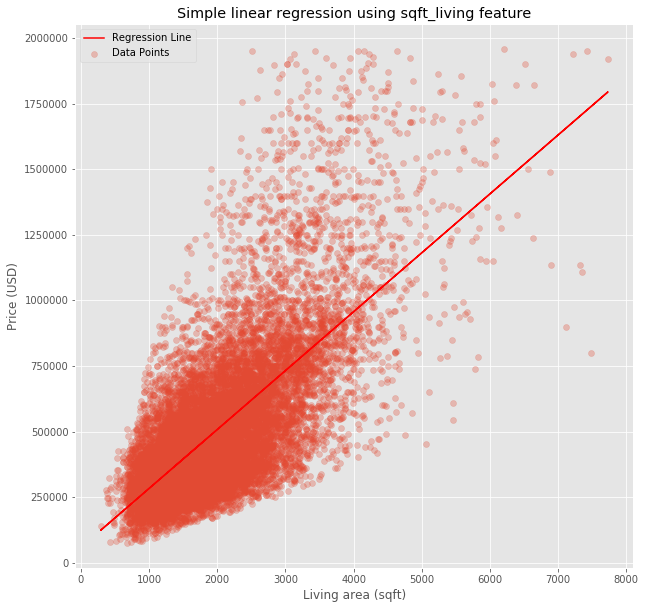

In [70]:
y_slr_pred = linreg.predict(X_slr_train)

plt.figure(figsize = (10,10))

# scatter plot
plt.scatter(x = X_slr_train, y = y_train, alpha = 0.3, label = 'Data Points')

# line plot
plt.plot(X_slr_train, y_slr_pred, color="red", label = "Regression Line")

plt.legend()
plt.title('Simple linear regression using sqft_living feature')
plt.xlabel('Living area (sqft)')
plt.ylabel('Price (USD)')
plt.show()

In [71]:
rmse_scores = np.sqrt(-scores)
display(rmse_scores)
display(rmse_scores.mean())
display(rmse_scores.std())

array([209116.21542797, 216880.94561212, 211911.1964882 , 202313.06090435,
       206796.06504113, 210606.39257729, 206586.92764877, 208232.4431842 ,
       209527.48258347, 207661.76831409])

208963.24977815832

3622.4096043220516

In [73]:
# Define table as a dataframe with specific columns. Each column's values will be a list that we will add to.
evaluationtable = pd.DataFrame({'Model': [], 'Description':[], ' Num Features' : [], 'R-squared':[], 'RMSE': []})

# Add data for simple linear regression
evaluationtable.loc[0] = ['Simple Linear Regression', 'Sqft_living', model.df_model, round(model.rsquared,3), int(rmse_scores.mean()) ]

# View our evaluation table
evaluationtable

,Model,Description,Num Features,R-squared,RMSE
0,Simple Linear Regression,Sqft_living,1.0,0.464,208963.0


### Test 

In [74]:
X_slr_test = np.array(df_test['sqft_living']).reshape(-1, 1)
y_test = df_test["price"]

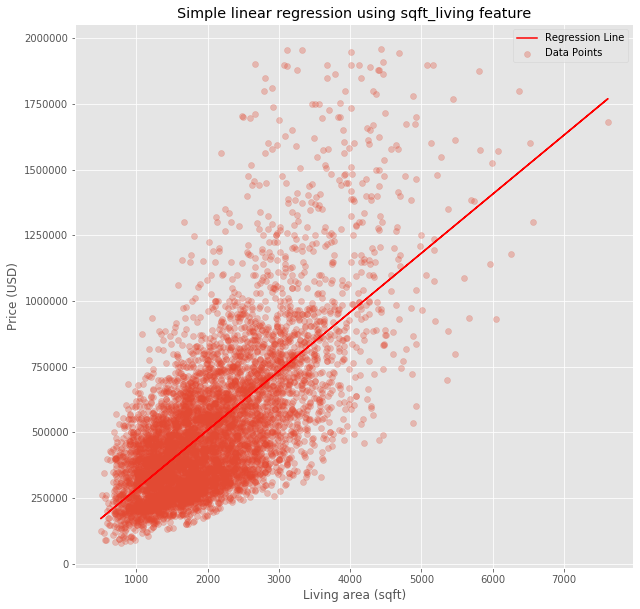

In [75]:
y_slr_test_pred = linreg.predict(X_slr_test)

plt.figure(figsize = (10,10))

# scatter plot
plt.scatter(x = X_slr_test, y = y_test, alpha = 0.3, label = 'Data Points')

# line plot
plt.plot(X_slr_test, y_slr_test_pred, color="red", label = "Regression Line")

plt.legend()
plt.title('Simple linear regression using sqft_living feature')
plt.xlabel('Living area (sqft)')
plt.ylabel('Price (USD)')
plt.show()

## Decision Tree Regression 

### Train

In [76]:
X_dtr_train = X_train
y_dtr_train = y_train

In [77]:
from sklearn.tree import DecisionTreeRegressor

In [93]:
for i in range(100, 120):
    dtr = DecisionTreeRegressor(random_state = 0, criterion="mse", splitter="best", max_depth=i)
    dtr.fit(X_dtr_train, y_dtr_train)
    y_dtr_pred = dtr.predict(X_dtr_train)
    y_tot = 0
    for y, y_pred in zip(y_dtr_train, y_dtr_pred):
        y_se = (y-y_pred)**2
        y_tot += y_se
    y_mse = y_tot/len(y_dtr_pred)
    print("max_depth {}: {}".format(i, y_mse))

max_depth 100: 41247.33603766026
max_depth 101: 41247.33603766026
max_depth 102: 41247.33603766026
max_depth 103: 41247.33603766026
max_depth 104: 41247.33603766026
max_depth 105: 41247.33603766026
max_depth 106: 41247.33603766026
max_depth 107: 41247.33603766026
max_depth 108: 41247.33603766026
max_depth 109: 41247.33603766026
max_depth 110: 41247.33603766026
max_depth 111: 41247.33603766026
max_depth 112: 41247.33603766026
max_depth 113: 41247.33603766026
max_depth 114: 41247.33603766026
max_depth 115: 41247.33603766026
max_depth 116: 41247.33603766026
max_depth 117: 41247.33603766026
max_depth 118: 41247.33603766026
max_depth 119: 41247.33603766026


We are going to take the value 80 as the max_depth because values above 80 overfits.

In [79]:
dtr = DecisionTreeRegressor(random_state = 0, criterion="mse", splitter="best", max_depth=90)
dtr

DecisionTreeRegressor(max_depth=90, random_state=0)

In [80]:
dtr.fit(X_dtr_train, y_dtr_train)

DecisionTreeRegressor(max_depth=90, random_state=0)

In [81]:
y_dtr_pred = dtr.predict(X_dtr_train)

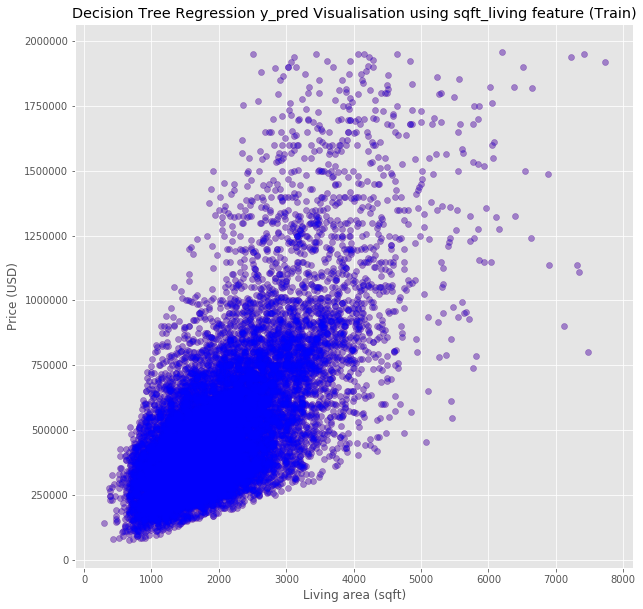

In [82]:
plt.figure(figsize = (10,10))

# scatter plot
plt.scatter(x = X_dtr_train["sqft_living"], y = y_dtr_train, alpha = 0.3, label = 'Data Points')

# line plot
# plt.plot(X_dtr_train["sqft_living"], y_dtr_pred, color="red", label = "Regression Line")
plt.scatter(X_dtr_train["sqft_living"], y_dtr_pred, color="blue", alpha=0.3, label = "Regression Line")

plt.title('Decision Tree Regression y_pred Visualisation using sqft_living feature (Train)')
plt.xlabel('Living area (sqft)')
plt.ylabel('Price (USD)')
plt.show()

### Test 

In [83]:
# test mse
y_tot = 0

for y, y_pred in zip(y_test, y_dtr_pred):
    y_se = (y-y_pred)**2
    y_tot += y_se

y_mse = y_tot/len(y_dtr_pred)

y_mse

69511402872.85834

In [84]:
y_test_dtr_pred = dtr.predict(X_test)

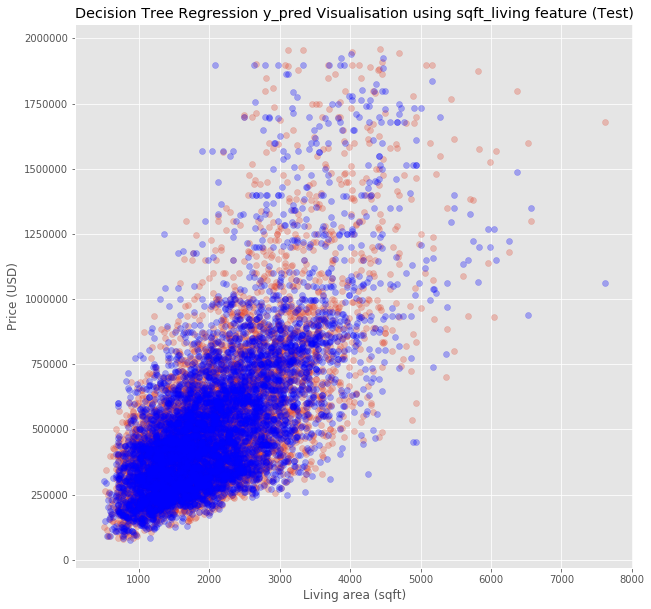

In [85]:
plt.figure(figsize = (10,10))

# scatter plot
plt.scatter(x = X_test["sqft_living"], y = y_test, alpha = 0.3, label = 'Data Points')

# line plot
# plt.plot(X_dtr_train["sqft_living"], y_dtr_pred, color="red", label = "Regression Line")
plt.scatter(X_test["sqft_living"], y_test_dtr_pred, color="blue", alpha=0.3, label = "Regression Line")

plt.title('Decision Tree Regression y_pred Visualisation using sqft_living feature (Test)')
plt.xlabel('Living area (sqft)')
plt.ylabel('Price (USD)')
plt.show()

In [86]:
from sklearn.metrics import r2_score
dtr_r2 = r2_score(y_test, y_test_dtr_pred)

In [87]:
rmse_scores = np.sqrt(y_mse)

In [88]:
# Add data for decision tree regression
evaluationtable.loc[1] = ['Decision Tree Regression', 'All Features', len(X_train.columns), round(dtr_r2,3), int(rmse_scores.mean())]

# View our evaluation table
evaluationtable

,Model,Description,Num Features,R-squared,RMSE
0,Simple Linear Regression,Sqft_living,1.0,0.464,208963.0
1,Decision Tree Regression,All Features,250.0,0.640,263650.0


# Conclusions

## How is your prediction task defined? And what is the meaning of the output variable?

The prediction task is to predict the house prices based on house features.

## How do you represent your data as features?

* id - unique identifier for a house
* date - Date of house sale
* price - Price is the prediction target
* bedrooms - Number of Bedrooms/House
* bathrooms - Number of bathrooms
* sqft_living - square footage of the home
* sqft_lot - square footage of the lot
* floors - Total floors (levels) in house
* waterfront - House which has a view to a waterfront
* view - The quality of view (0 - Bad, 4 - Very Good)
* condition - How good the condition is ( Overall )
* grade - overall grade given to the housing unit, based on King County grading system
* sqft_above - square footage of house apart from basement
* sqft_basement - square footage of the basement
* yr_built - Built Year
* yr_renovated - Year when house was renovated
* zipcode - zip
* lat - Latitude coordinate
* long - Longitude coordinate
* sqft_living15 - The square footage of interior housing living space for the nearest 15 neighbors
* sqft_lot15 - The square footage of the land lots of the nearest 15 neighbors

## Did you process the features in any way? 

* `Living/Lot Ratio` feature -> sqft_living/sqft_lot
* `resold` -> If the house has been resold within the dataset (boolean)
* `renovated90` -> renovated after 1990
* `month` -> the month where the house was sold
* `age` -> date(year) - yr_built
* encoded discrete values

## Did you bring any additional sources of data? 

According to an [article](https://www.realtor.com/advice/sell/if-i-take-out-the-tub-does-a-bathroom-still-count-as-a-full-bath/) from www.realtor.com, a full bathroom is made up of four parts: a sink, a shower, a bathtub, and a toilet. Hence, the `bathrooms` column refers to the number of bathrooms where the decimal points means that there are bathrooms without one/some of the four parts.

## How did you select which learning algorithms to use? 

1. Simple linear regression is the most widely used only considers 1 feature.
2. The next step to improve is to consider more features. We can use multivariable linear regression. However, it is susceptible to boolean values (one hot encoded). Hence, the mean square error is also higher.
3. To overcome the one hot encoded variables, decision tree regression is preferred as it evaluates left/right value.

## How do you evaluate the quality of your system? 

I am using root mean square error as a metric to evaluate my systems.

## How well does your system compare to a stupid baseline?
It has higher $R^2$ value than the stupid baseline. 0.640 - 0.464 = 0.176 increase.

## Can you say anything about the errors that the system makes?

* There is still a lot of noise in the data because I did not drop many of the outliers since I thought I could keep them. 
* I did not standardize the data. 
* There might be a more suitable model.
* The data might not be linear.

## Is it possible to say something about which features the model considers important?

The `sqft_living` feature is important because it has high correlation with the price from the beginning.

# References

https://github.com/nadinezab/kc-house-prices-prediction